In [64]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
from sklearn.model_selection import train_test_split
import seaborn as sns
import json

## Data preprocessing

### Original dataset with garden_door and hallway_door

In [65]:
# Load and preprocess door and window data
garden_door_df = pd.read_csv('datasets/Door_windows.csv')
garden_door_df = garden_door_df.drop('Door_balcony_1st_floor', axis=1)
garden_door_df = garden_door_df.drop('Door_Hallway', axis=1)
garden_door_df['Date'] = pd.to_datetime(garden_door_df['Date'], format='%d/%m/%Y %H:%M')
garden_door_df['Door_Garden'] = garden_door_df['Door_Garden'].map({'on': 1, 'off': 0})
garden_door_df = garden_door_df.drop_duplicates(subset='Date', keep='last')

# RESAMPLANJE U 1 SEKUNDU
garden_door_df.set_index('Date', inplace=True)
garden_door_df = garden_door_df.resample('1s').ffill()
garden_door_df.reset_index(inplace=True)
garden_door_df = garden_door_df.drop('Unnamed: 0', axis=1)
#garden_door_df.to_csv("datasets/garden_door_dataset.csv", index=False)

# Load and preprocess door and window data
hallway_door_df = pd.read_csv('datasets/Door_windows.csv')
hallway_door_df = hallway_door_df.drop('Door_balcony_1st_floor', axis=1)
hallway_door_df = hallway_door_df.drop('Door_Garden', axis=1)
hallway_door_df['Date'] = pd.to_datetime(hallway_door_df['Date'], format='%d/%m/%Y %H:%M')
hallway_door_df['Door_Hallway'] = hallway_door_df['Door_Hallway'].map({'on': 1, 'off': 0})
hallway_door_df = hallway_door_df.drop_duplicates(subset='Date', keep='last')

# RESAMPLANJE U 1 SEKUNDU
hallway_door_df.set_index('Date', inplace=True)
hallway_door_df = hallway_door_df.resample('1s').ffill()
hallway_door_df.reset_index(inplace=True)
hallway_door_df = hallway_door_df.drop('Unnamed: 0', axis=1)
#garden_door_df.to_csv("datasets/garden_door_dataset.csv", index=False)

sensor_df = pd.read_csv('datasets/LS0623020168.csv')
# Convert UTC to UTC+2
sensor_df['timestamp(ZG)'] = pd.to_datetime(sensor_df['timestamp(UTC)']) + timedelta(hours=2)

# Handling daylight savings ZG: (UTC+2) -> (UTC+1)
dst_cutoff = pd.Timestamp('2024-10-27 03:00:00')
sensor_df['timestamp(ZG)'] = sensor_df['timestamp(ZG)'].apply(
    lambda x: x - timedelta(hours=1) if x >= dst_cutoff else x
)

merged_df = pd.merge(sensor_df, garden_door_df[["Date", "Door_Garden"]],
                     left_on="timestamp(ZG)", right_on="Date", how="left")
merged_df = pd.merge(merged_df, hallway_door_df[["Date", "Door_Hallway"]],
                     left_on="timestamp(ZG)", right_on="Date", how="left")
merged_df = merged_df.drop(columns=["Date_x", "Date_y"])
merged_df = merged_df[merged_df["timestamp(ZG)"] >= garden_door_df['Date'].min()]

# Dropping duplicated values of timestamp resulted in moving the clock by 1 hour
merged_df = merged_df.drop_duplicates(subset='timestamp(ZG)', keep='first')
merged_df = merged_df.dropna()

#merged_df.to_csv("datasets/merged_sensor_data.csv", index=False)

### Motion dataset

In [66]:
motion_df = pd.read_csv('datasets/Motion.csv')
motion_df = motion_df.drop('Unnamed: 0', axis=1)
motion_df['Timestamp'] = pd.to_datetime(motion_df['Timestamp'], format='%Y-%m-%d %H:%M:%S')
motion_df = motion_df.set_index('Timestamp').resample('1s').ffill().reset_index()
# Merge motion detection data with primary dataset based on timestamps
merged_df = pd.merge_asof(
    merged_df.rename(columns={'timestamp(ZG)': 'timestamp'}).sort_values('timestamp'), 
    motion_df.rename(columns={'Timestamp': 'timestamp'}).sort_values('timestamp'), 
    on='timestamp',
    direction='backward'
).rename(columns={'timestamp': 'timestamp(ZG)'})
#merged_df.to_csv("datasets/merged_sensor_data_with_motion.csv", index=False)

### People dataset

In [67]:
people_df = pd.read_csv('datasets/People.csv')
people_df = people_df.drop('Unnamed: 0', axis=1)
people_df.rename(columns={'People in a room' : 'people_in_room'}, inplace= True)
people_df['Timestamp'] = pd.to_datetime(people_df['Timestamp'], format='%Y-%m-%d %H:%M:%S')
people_df = people_df.set_index('Timestamp').resample('1s').ffill().reset_index()
merged_df = pd.merge_asof(
    merged_df.rename(columns={'timestamp(ZG)': 'timestamp'}).sort_values('timestamp'), 
    people_df.rename(columns={'Timestamp': 'timestamp'}).sort_values('timestamp'), 
    on='timestamp',
    direction='backward'
).rename(columns={'timestamp': 'timestamp(ZG)'})

### Filling missing values of motion_detection based on people_in_room (not recommended)

In [68]:
# Fill missing values in 'motion_detection' based on 'people_in_room'
# merged_df['Motion_detection'] = merged_df['Motion_detection'].fillna(
#     merged_df['people_in_room'].apply(lambda x: 0 if x == 0 else 1)
# )

# we will not fill values, rather ignore when we have none
merged_df.dropna(inplace=True)


In [69]:
# Adding a "people" column if motion detected or people in room
merged_df['people'] = ((merged_df['Motion_detection'] != 0) | (merged_df['people_in_room'] != 0)).astype(int)

### Adding experiment column 

In [70]:
with open("datasets/experiments.json", "r") as file:
    experiment_data = json.load(file)

start_time = merged_df['timestamp(ZG)'].min()
end_time = merged_df['timestamp(ZG)'].max()

all_timestamps = pd.date_range(start=start_time, end=end_time, freq="1s")
experiment_df = pd.DataFrame({"Timestamp": all_timestamps, "experiment": 0})

for ranges in experiment_data["experiments"].values():
    for start, end in ranges:
        start, end = pd.to_datetime(start), pd.to_datetime(end)
        experiment_df.loc[(experiment_df['Timestamp'] >= start) & (experiment_df['Timestamp'] <= end), 'experiment'] = 1

merged_df = pd.merge_asof(
    merged_df.rename(columns={'timestamp(ZG)': 'timestamp'}).sort_values('timestamp'), 
    experiment_df.rename(columns={'Timestamp': 'timestamp'}).sort_values('timestamp'), 
    on='timestamp',
    direction='backward'
).rename(columns={'timestamp': 'timestamp(ZG)'})

# merged_df.to_csv("people_classifier_dataset.csv", index=False)

## Adding "Human Presence" Experiment to "People"

In [71]:
human_presence_intervals = [
    ("2024-10-19 12:02", "2024-10-19 12:53"),
    ("2024-10-19 13:34", "2024-10-19 14:08")
]

for start, end in human_presence_intervals:
    start_dt = pd.to_datetime(start)
    end_dt = pd.to_datetime(end)
    merged_df.loc[(merged_df['timestamp(ZG)'] >= start_dt) & (merged_df['timestamp(ZG)'] <= end_dt), 'people'] = 1

# merged_df.to_csv("people_classifier_dataset.csv", index=False)

## Adding a people_continuous based on Human Presence and the real data

- 19/10/2024 12:15 - 19/10/2024 12:15 = 1m
- 17 - 29 - 13m
- 30 - 33 - 4m
- 43 - 48 -6m 

- 19/10/2024 13:35 - 19/10/2024 13:39 = 5m
- 48-54 = 7m

Based on this small test sample, the worst discrepancy in the sensor data was 13 minutes, so we will set it to 15 minutes

In [72]:
# Step 1: Identify intervals when sensor is triggered (people == 1)
# We'll detect state changes to group consecutive 1's.
merged_df['prev'] = merged_df['people'].shift(fill_value=0)
merged_df['change'] = merged_df['people'] != merged_df['prev']

# Get indices where the state changes
change_indices = merged_df.index[merged_df['change']].tolist()

intervals = []
current_state = merged_df.loc[change_indices[0], 'people']
start_time = merged_df.loc[change_indices[0], 'timestamp(ZG)']

for idx in change_indices[1:]:
    state = merged_df.loc[idx, 'people']
    time_val = merged_df.loc[idx, 'timestamp(ZG)']
    if state != current_state:
        # If the state was 1, then record that interval.
        if current_state == 1:
            intervals.append((start_time, time_val))
        start_time = time_val
        current_state = state

# If the last state is 1, record the interval until the end of the DataFrame.
if current_state == 1:
    intervals.append((start_time, merged_df['timestamp(ZG)'].iloc[-1]))

# Step 2: Merge intervals with gaps less than the threshold (5 minutes)
threshold = pd.Timedelta(minutes=15)
merged_intervals = []
if intervals:
    current_start, current_end = intervals[0]
    for start, end in intervals[1:]:
        # If gap between current interval end and next start is less than threshold, merge them.
        if start - current_end < threshold:
            current_end = end  # extend the current interval
        else:
            merged_intervals.append((current_start, current_end))
            current_start, current_end = start, end
    merged_intervals.append((current_start, current_end))

# Step 3: Create a new column with merged people detection.
# Initialize a new column (e.g. "people_merged") to 0.
merged_df['people_continuous'] = 0

# For each merged interval, mark the corresponding rows as 1.
for start, end in merged_intervals:
    merged_df.loc[(merged_df['timestamp(ZG)'] >= start) & (merged_df['timestamp(ZG)'] < end), 'people_continuous'] = 1

# (Optional) Drop helper columns.
merged_df.drop(columns=['prev', 'change'], inplace=True)

# merged_df.to_csv("people_classifier_dataset.csv", index=False)

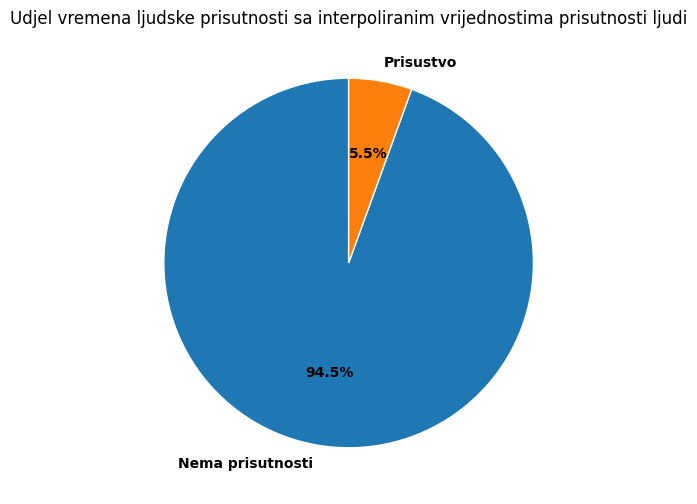

In [73]:
# 5) Prebroji koliko sekundi je flag=1 ili 0
counts = merged_df['people_continuous'].value_counts().sort_index()
labels = ['Nema prisutnosti', 'Prisustvo']
sizes  = [counts.get(0, 0), counts.get(1, 0)]

# 6) Nacrtaj pie-chart
plt.figure(figsize=(6, 6))
plt.pie(
    sizes, 
    labels=labels, 
    autopct='%1.1f%%', 
    startangle=90, 
    wedgeprops=dict(edgecolor='w'),
    textprops={'fontweight': 'bold'}
)
plt.title('Udjel vremena ljudske prisutnosti sa interpoliranim vrijednostima prisutnosti ljudi')
plt.show()


## REMOVING ALL THE LABELED DATA, UNLESS PEOPLE (continuous) ARE IN ROOM

In [74]:
# Calculate the original number of rows
original_row_count = merged_df.shape[0]
people_count = (merged_df['people_continuous'] == 1).sum()
garden_door_count = (merged_df['Door_Garden'] == 1).sum()
hallway_door_count = (merged_df['Door_Hallway'] == 1).sum()


# Define the columns to check
columns_to_check = ['Door_Garden', 'Door_Hallway', 'experiment']

# Apply the filtering condition
merged_df = merged_df[
    ~((merged_df[columns_to_check].any(axis=1)) & (merged_df['people_continuous'] == 0))
]

# Calculate the number of rows remaining after filtering
remaining_row_count = merged_df.shape[0]

# Calculate the number of rows deleted
rows_deleted = original_row_count - remaining_row_count

# Calculate the percentage of rows deleted
percentage_deleted = (rows_deleted / original_row_count) * 100

people_count2 = (merged_df['people_continuous'] == 1).sum()
garden_door_count2 = (merged_df['Door_Garden'] == 1).sum()
hallway_door_count2 = (merged_df['Door_Hallway'] == 1).sum()

# Print the results
print(f"Original total number of rows: {original_row_count}")
print(f"Total number of rows deleted: {rows_deleted}")
print(f"Percentage of total rows deleted: {percentage_deleted:.2f}%")

# print(f"Before number of people rows: {people_count}, after number of people rows: {people_count2}")
print(f"Before number of garden door rows: {garden_door_count}, after number of garden door rows: {garden_door_count2}. Meaning that {100*(1-garden_door_count2/garden_door_count):.2f}% were deleted")
print(f"Before number of hallway door rows: {hallway_door_count}, after number of hallway door rows: {hallway_door_count2}. Meaning that {100*(1-hallway_door_count2/hallway_door_count):.2f}% were deleted")


Original total number of rows: 291661
Total number of rows deleted: 9794
Percentage of total rows deleted: 3.36%
Before number of garden door rows: 7081, after number of garden door rows: 4035. Meaning that 43.02% were deleted
Before number of hallway door rows: 8909, after number of hallway door rows: 4261. Meaning that 52.17% were deleted


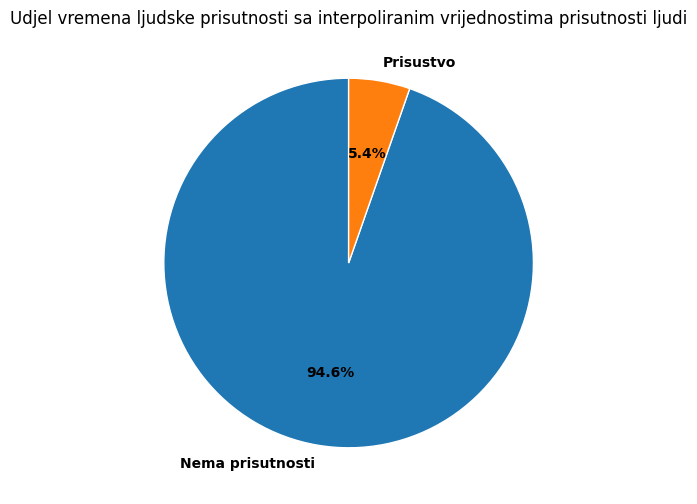

In [63]:
# 5) Prebroji koliko sekundi je flag=1 ili 0
counts = merged_df['people_continuous'].value_counts().sort_index()
labels = ['Nema prisutnosti', 'Prisustvo']
sizes  = [counts.get(0, 0), counts.get(1, 0)]

# 6) Nacrtaj pie-chart
plt.figure(figsize=(6, 6))
plt.pie(
    sizes, 
    labels=labels, 
    autopct='%1.1f%%', 
    startangle=90, 
    wedgeprops=dict(edgecolor='w'),
    textprops={'fontweight': 'bold'}
)
plt.title('Udjel vremena ljudske prisutnosti sa interpoliranim vrijednostima prisutnosti ljudi')
plt.show()


## Visualizing the data

For visualizing door opening, the data is reduced from 5s to 1m readings, the sensor data is the average value in that 1 minute, each day is saved as image in daily_plots

In [13]:
"""# Generating images by days
import os

parameters = [
    ('NetCO2-CO2_ug', 'NetCO2-CO2 (µg)'),
    ('NetADC_O3-O3_ug', 'NetADC_O3-O3 (µg)'),
    ('NetADC_CO-CO_ug', 'NetADC_CO-CO (µg)'),
    ('NetPM-PM10(µg/m3)', 'NetPM-PM10 (µg/m³)'),
    ('NetPM-PM25(µg/m3)', 'NetPM-PM25 (µg/m³)'),
    ('NetPid_P1-PPB_ug', 'NetPid_P1-PPB (µg)'),
    ('NetBME280-PERC(%)', 'NetBME280 Humidity (%)'),
    ('NetBME280-TEMP_EXT(°C)', 'NetBME280 Temperature (°C)'),
    ('NetBME280-HPA(hPa)', 'NetBME280 Pressure (hPa)'),
    ('NetADC_NO2-NO2_ug', 'NetADC_NO2-NO2 (µg)'),
    ('Door_Hallway', 'Door_Hallway'),
    ('Door_Garden', 'Door_Garden'),
    # ('Motion_detection', 'Motion_detection'),
    # ('people_in_room', 'people_in_room')
]

merged_df = merged_df.drop('timestamp(UTC)', axis=1)

# Set the UTC+1 timestamp as the index
merged_df.set_index('timestamp(ZG)', inplace=True)

# Resample the data to 1-minute intervals and calculate the mean
data_resampled = merged_df.resample('1min').mean()

# Reset the index to make 'timestamp(ZG)' a column again
data_resampled = data_resampled.reset_index()

# Ensure the directory for saving plots exists
output_dir = "daily_people_continuous_filtered"
os.makedirs(output_dir, exist_ok=True)

# Loop through each unique day in the dataset
data_resampled['date'] = data_resampled['timestamp(ZG)'].dt.date
unique_days = data_resampled['date'].unique()

for day in unique_days:
    # Filter data for the specific day
    day_data = data_resampled[data_resampled['date'] == day]
    people_times = day_data[day_data['people_continuous'] == 1]['timestamp(ZG)']
    
    # Set up a figure for the subplots
    fig, axs = plt.subplots(6, 2, figsize=(15, 22))
    fig.suptitle(
        f'Time series of parameters for {day}, people gaps of 15min filled, removed labeled data, red line = people, ', 
        fontsize=16
    )
    
    # Plot each parameter in a separate subplot
    for i, (param, title) in enumerate(parameters):
        row, col = divmod(i, 2)
        axs[row, col].plot(day_data['timestamp(ZG)'], day_data[param])
        axs[row, col].set_title(title)
        axs[row, col].set_xlabel('Time')
        axs[row, col].set_ylabel(title)
        axs[row, col].tick_params(axis='x', rotation=45)
        
        # Add vertical lines for door open times with color
        for people_time in people_times:
            people_time_data = day_data[day_data['timestamp(ZG)'] == people_time]
            if (people_time_data['people_continuous'].values == 1):
                axs[row, col].axvline(x=people_time, color='red', lw=1, alpha=0.2)
        
    
    # Remove unused subplots if they exist
    for j in range(len(parameters), len(axs.flatten())):
        fig.delaxes(axs.flatten()[j])
    
    # Adjust layout and save the plot
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust layout to fit title
    plt.savefig(os.path.join(output_dir, f'{day}.png'))
    plt.close(fig)"""

'# Generating images by days\nimport os\n\nparameters = [\n    (\'NetCO2-CO2_ug\', \'NetCO2-CO2 (µg)\'),\n    (\'NetADC_O3-O3_ug\', \'NetADC_O3-O3 (µg)\'),\n    (\'NetADC_CO-CO_ug\', \'NetADC_CO-CO (µg)\'),\n    (\'NetPM-PM10(µg/m3)\', \'NetPM-PM10 (µg/m³)\'),\n    (\'NetPM-PM25(µg/m3)\', \'NetPM-PM25 (µg/m³)\'),\n    (\'NetPid_P1-PPB_ug\', \'NetPid_P1-PPB (µg)\'),\n    (\'NetBME280-PERC(%)\', \'NetBME280 Humidity (%)\'),\n    (\'NetBME280-TEMP_EXT(°C)\', \'NetBME280 Temperature (°C)\'),\n    (\'NetBME280-HPA(hPa)\', \'NetBME280 Pressure (hPa)\'),\n    (\'NetADC_NO2-NO2_ug\', \'NetADC_NO2-NO2 (µg)\'),\n    (\'Door_Hallway\', \'Door_Hallway\'),\n    (\'Door_Garden\', \'Door_Garden\'),\n    # (\'Motion_detection\', \'Motion_detection\'),\n    # (\'people_in_room\', \'people_in_room\')\n]\n\nmerged_df = merged_df.drop(\'timestamp(UTC)\', axis=1)\n\n# Set the UTC+1 timestamp as the index\nmerged_df.set_index(\'timestamp(ZG)\', inplace=True)\n\n# Resample the data to 1-minute intervals and 

## Data normalization

In [35]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

parameters_to_normalize = [
    'NetCO2-CO2(ppm)', 'NetCO2-CO2_ug', 'NetADC_O3-O3_ug',
    'NetADC_O3-O3(ppb)', 'NetADC_CO-CO_ug', 'NetADC_CO-CO( ppb)',
    'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB(ppm)',
    'NetPid_P1-PPB_ug', 'NetBME280-PERC(%)', 'NetBME280-TEMP_EXT(°C)',
    'NetBME280-HPA(hPa)', 'NetADC_NO2-NO2_ug', 'NetADC_NO2-NO2(ppb)'
]

#scaler = MinMaxScaler()  # Use StandardScaler() for Z-score normalization
scaler = StandardScaler()
sensor_df_normalized = merged_df.copy()
sensor_df_normalized[parameters_to_normalize] = scaler.fit_transform(merged_df[parameters_to_normalize])

# MODELS


In [36]:
from sklearn.metrics import confusion_matrix, classification_report, matthews_corrcoef
from sklearn.metrics import ConfusionMatrixDisplay

def evaluate_model(y_pred, y_test, name):
    cm = confusion_matrix(y_test, y_pred)
    mcc = matthews_corrcoef(y_test, y_pred)
    print("="*50)
    print(f"Results for {name}:")
    print(f"MCC: {mcc:.4f}")
    print("Classification Report:\n", classification_report(y_test, y_pred))
    print("Confusion Matrix:\n")
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
    disp.plot(cmap=plt.cm.Blues)
    plt.title(f"Confusion Matrix for {name}")
    plt.show()
    print("="*50)

# RFC

In [70]:
from sklearn.ensemble import RandomForestClassifier

# Define your features and target.
features = ['NetCO2-CO2_ug', 'NetADC_O3-O3_ug', 'NetADC_CO-CO_ug',
            'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB_ug',
            'NetADC_NO2-NO2_ug']

# Assume sensor_df_normalized and merged_df are already defined.
X = sensor_df_normalized[features].values
y = merged_df['people_continuous'].values


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)
rfc = RandomForestClassifier(random_state=42)
rfc.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

Results for RFC:
MCC: 0.3385
Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.96      0.95     51757
           1       0.44      0.34      0.38      4617

    accuracy                           0.91     56374
   macro avg       0.69      0.65      0.67     56374
weighted avg       0.90      0.91      0.91     56374

Confusion Matrix:



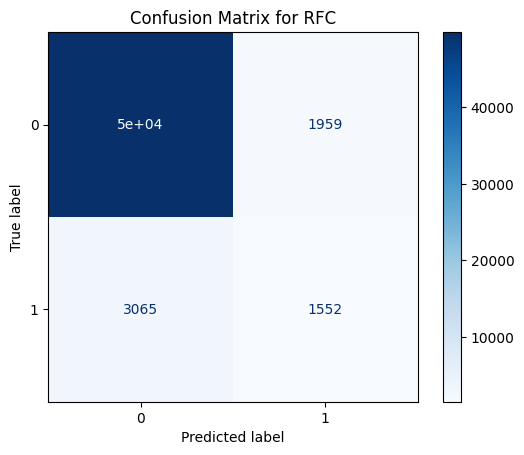

In [72]:
y_pred = rfc.predict(X_test)
evaluate_model(y_pred, y_test, "RFC")

# PEOPLE, GAP FILLING: 15min, REMOVED LABELED UNLESS PEOPLE = 1, REMOVED FILLED VALUES OF MOTION BASED ON PEOPLE_IN_ROOM
# MCC: 0.3385

# PEOPLE, GAP FILLING: 10min, REMOVED LABELED UNLESS PEOPLE = 1, REMOVED FILLED VALUES OF MOTION BASED ON PEOPLE_IN_ROOM
# MCC: 0.2799



Fold 1
Time interval for fold 1: 2024-10-17 10:07:40 to 2024-10-20 04:30:51
Fold 1 - Accuracy: 0.9409, MCC: 0.3749



Fold 2
Time interval for fold 2: 2024-10-20 04:30:56 to 2024-10-23 04:04:37
Fold 2 - Accuracy: 0.7850, MCC: -0.0955



Fold 3
Time interval for fold 3: 2024-10-23 04:04:42 to 2024-10-25 22:07:11
Fold 3 - Accuracy: 0.6237, MCC: -0.0449



Fold 4
Time interval for fold 4: 2024-10-25 22:07:16 to 2024-10-28 15:10:28
Fold 4 - Accuracy: 0.8766, MCC: -0.0364



Fold 5
Time interval for fold 5: 2024-10-28 15:10:33 to 2024-10-31 11:22:12
Fold 5 - Accuracy: 0.8970, MCC: 0.3471


List of fold accuracies: [0.9408646784596717, 0.7850224577984971, 0.6236881878366008, 0.8766417608616983, 0.8969921450922792]
List of fold MCC's: [0.37486578692308176, -0.09553582955699845, -0.044907006217098935, -0.03637343175580425, 0.34706258551113345]
Results for RFC Cross-Validated:
MCC: 0.0764
Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.86      0.90    220433
           1       0.11      0.25      0.15     14452

    accuracy                           0.82    234885
   macro avg       0.53      0.56      0.53    234885
weighted avg       0.89      0.82      0.86    234885

Confusion Matrix:



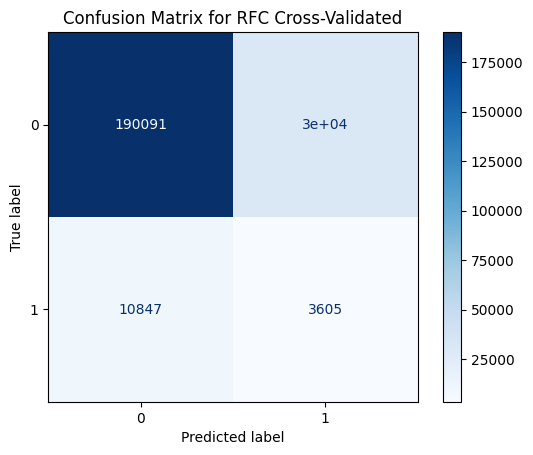

In [ ]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from sklearn.model_selection import TimeSeriesSplit
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, matthews_corrcoef

# Ensure the timestamp column is in datetime format
merged_df["timestamp(ZG)"] = pd.to_datetime(merged_df["timestamp(ZG)"])

# Prepare containers for aggregated predictions and ground truth
all_y_test = []
all_y_pred = []
fold_accuracies = []
fold_mccs = []

# Define TimeSeriesSplit (e.g., 5 folds)
tscv = TimeSeriesSplit(n_splits=5)
fold = 1

# Define your features and target.
features = ['NetCO2-CO2_ug', 'NetADC_O3-O3_ug', 'NetADC_CO-CO_ug',
            'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB_ug',
            'NetADC_NO2-NO2_ug']

# Assume sensor_df_normalized and merged_df are already defined.
X = sensor_df_normalized[features].values
y = merged_df[['people_continuous']].values

for train_index, test_index in tscv.split(X):
    print(f"\nFold {fold}")
    
    # Print the time interval for the test set of this fold
    start_time = merged_df["timestamp(ZG)"].iloc[test_index[0]]
    end_time = merged_df["timestamp(ZG)"].iloc[test_index[-1]]
    print(f"Time interval for fold {fold}: {start_time} to {end_time}")
    
    # Create training and test sets for current fold
    X_train_fold, X_test_fold = X[train_index], X[test_index]
    y_train_fold, y_test_fold = y[train_index], y[test_index]
    
    # Initialize and train the RandomForestClassifier for the current fold
    rfc = RandomForestClassifier(random_state=42)
    rfc.fit(X_train_fold, y_train_fold.ravel())
    
    # Get binary predictions on the test set of the current fold
    y_pred_fold = rfc.predict(X_test_fold)
    
    # Evaluate predictions using accuracy and MCC
    accuracy = accuracy_score(y_test_fold, y_pred_fold)
    mcc = matthews_corrcoef(y_test_fold, y_pred_fold)
    print(f"Fold {fold} - Accuracy: {accuracy:.4f}, MCC: {mcc:.4f}")
    fold_accuracies.append(accuracy)
    fold_mccs.append(mcc)
    
    # Store the predictions and ground truth for later aggregation
    all_y_test.append(y_test_fold)
    all_y_pred.append(y_pred_fold)
    
    # --- Create Interactive Plot using Plotly for the current fold ---
    # Get the corresponding timestamps for the test set
    fold_timestamps = merged_df["timestamp(ZG)"].iloc[test_index].reset_index(drop=True)
    # Flatten the arrays in case they're 2D
    y_test_flat = y_test_fold.flatten()
    y_pred_flat = y_pred_fold.flatten()
    
    # Create a DataFrame for plotting
    df_plot = pd.DataFrame({
        'timestamp': fold_timestamps,
        'Actual': y_test_flat,
        'Predicted': y_pred_flat
    })
    
    # Create interactive Plotly figure
    fig = go.Figure()
    
    fig.add_trace(go.Scatter(
        x=df_plot['timestamp'],
        y=df_plot['Actual'],
        mode='lines',
        name='Actual People'
    ))
    fig.add_trace(go.Scatter(
        x=df_plot['timestamp'],
        y=df_plot['Predicted'],
        mode='lines',
        name='Predicted People',
        line=dict(dash='dot')
    ))
    
    fig.update_layout(
        title=f'Fold {fold} Actual vs Predicted People',
        xaxis_title='Time',
        yaxis_title='People Value',
        width=1400,
        height=700,
        xaxis=dict(
            rangeselector=dict(
                buttons=list([
                    dict(count=1, label="1d", step="day", stepmode="backward"),
                    dict(step="all")
                ])
            ),
            rangeslider=dict(visible=True),
            type="date"
        )
    )
    
    fig.show()
    # ---------------------------------------------------------
    
    fold += 1

# Concatenate the arrays from all folds
all_y_test = np.concatenate(all_y_test, axis=0)
all_y_pred = np.concatenate(all_y_pred, axis=0)

print(f"List of fold accuracies: {fold_accuracies}")
print(f"List of fold MCC's: {fold_mccs}")

In [ ]:
evaluate_model(all_y_pred, all_y_test, "RFC Cross-Validated")

# PEOPLE, GAP FILLING: 15min, REMOVED LABELED UNLESS PEOPLE = 1, REMOVED FILLED VALUES OF MOTION BASED ON PEOPLE_IN_ROOM
# List of fold MCC's: [0.37486578692308176, -0.09553582955699845, -0.044907006217098935, -0.03637343175580425, 0.34706258551113345]
# MCC: 0.0764

# GRU

In [357]:
"""import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from sklearn.metrics import matthews_corrcoef
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping

# Define your features and target.
features = ['NetCO2-CO2_ug', 'NetADC_O3-O3_ug', 'NetADC_CO-CO_ug',
            'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB_ug',
            'NetADC_NO2-NO2_ug']

# Assume sensor_df_normalized and merged_df are already defined.
X = sensor_df_normalized[features].values
y = merged_df[['people']].values

# Split data (using a simple train/test split).
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Reshape data for GRU input (samples, timesteps, features).
# Here we use a single timestep.
X_train = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Build the GRU model.
model = Sequential([
    GRU(16, activation='tanh', return_sequences=False, 
        input_shape=(X_train.shape[1], X_train.shape[2])),
    Dropout(0.2),
    Dense(8, activation='relu'),
    Dropout(0.2),
    Dense(1, activation='sigmoid')  # For binary classification
])

# Compile the model.
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Define early stopping.
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Train the model.
history = model.fit(
    X_train, y_train,
    validation_data=(X_test, y_test),
    epochs=30,
    batch_size=32,
    verbose=1,
    callbacks=[early_stopping]
)

# Predict probabilities on the test set.
y_pred_prob = model.predict(X_test)"""

"import numpy as np\nimport pandas as pd\nimport matplotlib.pyplot as plt\nfrom tqdm import tqdm\nfrom sklearn.model_selection import train_test_split\nfrom sklearn.metrics import matthews_corrcoef\nimport tensorflow as tf\nfrom tensorflow.keras.models import Sequential\nfrom tensorflow.keras.layers import GRU, Dense, Dropout\nfrom tensorflow.keras.callbacks import EarlyStopping\n\n# Define your features and target.\nfeatures = ['NetCO2-CO2_ug', 'NetADC_O3-O3_ug', 'NetADC_CO-CO_ug',\n            'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB_ug',\n            'NetADC_NO2-NO2_ug']\n\n# Assume sensor_df_normalized and merged_df are already defined.\nX = sensor_df_normalized[features].values\ny = merged_df[['people']].values\n\n# Split data (using a simple train/test split).\nX_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)\n\n# Reshape data for GRU input (samples, timesteps, features).\n# Here we use a single timestep.\nX_train = X_train.r

In [358]:
"""# PEOPLE, THRESHOLD FILLING: 0, REMOVED LABELED, UNLESS PEOPLE = 1
# Best MCC: 0.4674 at Threshold: 0.17899999999999985

best_mcc = -1  # MCC ranges from -1 to 1
best_threshold = 0

for threshold in np.arange(0.01, 0.7, 0.001):
    # Binarize the predictions based on the threshold
    y_pred = (y_pred_prob > threshold).astype(int)
    
    mcc = matthews_corrcoef(y_test, y_pred)
    if mcc > best_mcc:
        best_mcc = mcc
        best_threshold = threshold

y_pred_class = (y_pred_prob > best_threshold).astype(int)

print(f"Best MCC: {best_mcc:.4f} at Threshold: {best_threshold}")
evaluate_model(y_pred_class, y_test, "GRU v2")"""

'# PEOPLE, THRESHOLD FILLING: 0, REMOVED LABELED, UNLESS PEOPLE = 1\n# Best MCC: 0.4674 at Threshold: 0.17899999999999985\n\nbest_mcc = -1  # MCC ranges from -1 to 1\nbest_threshold = 0\n\nfor threshold in np.arange(0.01, 0.7, 0.001):\n    # Binarize the predictions based on the threshold\n    y_pred = (y_pred_prob > threshold).astype(int)\n    \n    mcc = matthews_corrcoef(y_test, y_pred)\n    if mcc > best_mcc:\n        best_mcc = mcc\n        best_threshold = threshold\n\ny_pred_class = (y_pred_prob > best_threshold).astype(int)\n\nprint(f"Best MCC: {best_mcc:.4f} at Threshold: {best_threshold}")\nevaluate_model(y_pred_class, y_test, "GRU v2")'

# GRU WITH CROSS-VALIDATION 

In [41]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import matthews_corrcoef
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping

# Ensure the timestamp column is in datetime format
merged_df["timestamp(ZG)"] = pd.to_datetime(merged_df["timestamp(ZG)"])

# Prepare containers for aggregated predictions and ground truth
all_y_test = []
all_y_pred = []
best_mccs = []

# Define TimeSeriesSplit (e.g., 5 folds)
tscv = TimeSeriesSplit(n_splits=5)
fold = 1

# Define your features and target.
features = ['NetCO2-CO2_ug', 'NetADC_O3-O3_ug', 'NetADC_CO-CO_ug',
            'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB_ug',
            'NetADC_NO2-NO2_ug']

# Assume sensor_df_normalized and merged_df are already defined.
X = sensor_df_normalized[features].values
y = merged_df[['people_continuous']].values

for train_index, test_index in tscv.split(X):
    print(f"\nFold {fold}")
    
    # Print the time interval for the test set of this fold
    start_time = merged_df["timestamp(ZG)"].iloc[test_index[0]]
    end_time = merged_df["timestamp(ZG)"].iloc[test_index[-1]]
    print(f"Time interval for fold {fold}: {start_time} to {end_time}")
    
    # Create training and test sets for current fold
    X_train_fold, X_test_fold = X[train_index], X[test_index]
    y_train_fold, y_test_fold = y[train_index], y[test_index]
    
    # Reshape for GRU input (samples, timesteps, features)
    X_train_fold = X_train_fold.reshape(X_train_fold.shape[0], 1, X_train_fold.shape[1])
    X_test_fold = X_test_fold.reshape(X_test_fold.shape[0], 1, X_test_fold.shape[1])
    
    # Define a new GRU model for this fold
    model = Sequential([
        GRU(16, activation='tanh', return_sequences=False, 
            input_shape=(X_train_fold.shape[1], X_train_fold.shape[2])),
        Dropout(0.2),
        Dense(8, activation='relu'),
        Dropout(0.2),
        Dense(1, activation='sigmoid')  # Binary classification
    ])
    
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    
    # Train the model on the current fold
    history = model.fit(
        X_train_fold, y_train_fold,
        validation_data=(X_test_fold, y_test_fold),
        epochs=30,
        batch_size=32,
        verbose=1,
        callbacks=[early_stopping]
    )
    
    # Predict probabilities on the test set of the current fold
    y_pred_prob_fold = model.predict(X_test_fold)
    
    # Find the best threshold for this fold using MCC
    best_mcc = -1
    best_threshold = 0
    for threshold in np.arange(0.01, 0.8, 0.001):
        y_pred_temp = (y_pred_prob_fold > threshold).astype(int)
        mcc = matthews_corrcoef(y_test_fold, y_pred_temp)
        if mcc > best_mcc:
            best_mcc = mcc
            best_threshold = threshold
    
    print(f"Fold {fold} - Best MCC: {best_mcc:.4f} at Threshold: {best_threshold:.4f}")
    
    # Apply the best threshold to obtain binary predictions for this fold
    y_pred_fold = (y_pred_prob_fold > best_threshold).astype(int)
    
    # Store the predictions and ground truth for later aggregation
    all_y_test.append(y_test_fold)
    all_y_pred.append(y_pred_fold)
    best_mccs.append(best_mcc)
    
    # --- Interaktivni graf za trenutni presjek (fold) ---
    # Dohvati vremenske oznake (timestamps) za test-skup
    fold_timestamps = merged_df["timestamp(ZG)"].iloc[test_index].reset_index(drop=True)

    # Poravnaj (flatten) vektore u slučaju da su 2D
    y_test_flat = y_test_fold.flatten()
    y_pred_flat = y_pred_fold.flatten()

    # DataFrame za crtanje
    df_plot = pd.DataFrame({
        'timestamp': fold_timestamps,
        'Stvarno': y_test_flat,
        'Predviđeno': y_pred_flat
    })

    # Kreiraj interaktivni Plotly-graf
    fig = go.Figure()

    fig.add_trace(go.Scatter(
        x=df_plot['timestamp'],
        y=df_plot['Stvarno'],
        mode='lines',
        name='Stvarna prisutnost ljudi',
        line_shape='hv',        # horizontal then vertical
        connectgaps=False       # don’t interpolate across missing points
    ))
    fig.add_trace(go.Scatter(
        x=df_plot['timestamp'],
        y=df_plot['Predviđeno'],
        mode='lines',
        name='Predviđena prisutnost ljudi',
        line_shape='hv',        
        line=dict(dash='dot'),
        connectgaps=False
    ))

    fig.update_layout(
        title=f'Presjek {fold}: Stvarni vs. predviđeni broj ljudi',
        xaxis_title='Vrijeme',
        yaxis_title='Prisutnost ljudi',
        width=1400,
        height=700,
        xaxis=dict(
            rangeselector=dict(
                buttons=list([
                    dict(count=1, label="1 dan", step="day", stepmode="backward"),
                    dict(step="all", label="Sve")
                ])
            ),
            rangeslider=dict(visible=True),
            type="date"
        )
    )

    fig.show()

    # ---------------------------------------------------------
    
    fold += 1
# Concatenate the arrays from all folds
all_y_test = np.concatenate(all_y_test, axis=0)
all_y_pred = np.concatenate(all_y_pred, axis=0)



Fold 1
Time interval for fold 1: 2024-10-17 10:07:40 to 2024-10-20 04:30:51
Epoch 1/30


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



1469/1469 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - accuracy: 0.9384 - loss: 0.2652 - val_accuracy: 0.9484 - val_loss: 0.1848
Epoch 2/30
1469/1469 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.9621 - loss: 0.1576 - val_accuracy: 0.9484 - val_loss: 0.2206
Epoch 3/30
1469/1469 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9641 - loss: 0.1384 - val_accuracy: 0.9484 - val_loss: 0.2210
Epoch 4/30
1469/1469 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.9645 - loss: 0.1290 - val_accuracy: 0.9484 - val_loss: 0.2387
Epoch 5/30
1469/1469 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.9638 - loss: 0.1277 - val_accuracy: 0.9484 - val_loss: 0.2488
Epoch 6/30
1469/1469 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.9633 - loss: 0.1258 - val_accuracy: 0.9487 - val_loss: 0.2547
1469/1469 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
Fold 1 - Best MCC: 0.3625 at Threshold: 0.0490



Fold 2
Time interval for fold 2: 2024-10-20 04:30:56 to 2024-10-23 04:04:37


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/30
2937/2937 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9556 - loss: 0.2108 - val_accuracy: 0.9349 - val_loss: 0.2633
Epoch 2/30
2937/2937 ━━━━━━━━━━━━━━━━━━━━ 10s 2ms/step - accuracy: 0.9568 - loss: 0.1490 - val_accuracy: 0.9349 - val_loss: 0.3206
Epoch 3/30
2937/2937 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - accuracy: 0.9586 - loss: 0.1353 - val_accuracy: 0.9349 - val_loss: 0.3242
Epoch 4/30
2937/2937 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9579 - loss: 0.1320 - val_accuracy: 0.9349 - val_loss: 0.3463
Epoch 5/30
2937/2937 ━━━━━━━━━━━━━━━━━━━━ 11s 3ms/step - accuracy: 0.9565 - loss: 0.1316 - val_accuracy: 0.9349 - val_loss: 0.3521
Epoch 6/30
2937/2937 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step - accuracy: 0.9579 - loss: 0.1280 - val_accuracy: 0.9320 - val_loss: 0.3504
1469/1469 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
Fold 2 - Best MCC: 0.2352 at Threshold: 0.0160



Fold 3
Time interval for fold 3: 2024-10-23 04:04:42 to 2024-10-25 22:07:11


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/30
4405/4405 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9336 - loss: 0.2471 - val_accuracy: 0.9225 - val_loss: 0.1870
Epoch 2/30
4405/4405 ━━━━━━━━━━━━━━━━━━━━ 12s 3ms/step - accuracy: 0.9495 - loss: 0.1765 - val_accuracy: 0.9245 - val_loss: 0.2231
Epoch 3/30
4405/4405 ━━━━━━━━━━━━━━━━━━━━ 18s 2ms/step - accuracy: 0.9498 - loss: 0.1639 - val_accuracy: 0.9245 - val_loss: 0.2020
Epoch 4/30
4405/4405 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9499 - loss: 0.1595 - val_accuracy: 0.9239 - val_loss: 0.1935
Epoch 5/30
4405/4405 ━━━━━━━━━━━━━━━━━━━━ 8s 2ms/step - accuracy: 0.9510 - loss: 0.1569 - val_accuracy: 0.9236 - val_loss: 0.2232
Epoch 6/30
4405/4405 ━━━━━━━━━━━━━━━━━━━━ 9s 2ms/step - accuracy: 0.9513 - loss: 0.1530 - val_accuracy: 0.9239 - val_loss: 0.2069
1469/1469 ━━━━━━━━━━━━━━━━━━━━ 2s 928us/step
Fold 3 - Best MCC: 0.5566 at Threshold: 0.1510



Fold 4
Time interval for fold 4: 2024-10-25 22:07:16 to 2024-10-28 15:10:28


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/30
5873/5873 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9283 - loss: 0.2503 - val_accuracy: 0.9858 - val_loss: 0.0495
Epoch 2/30
5873/5873 ━━━━━━━━━━━━━━━━━━━━ 9s 2ms/step - accuracy: 0.9444 - loss: 0.1730 - val_accuracy: 0.9858 - val_loss: 0.0499
Epoch 3/30
5873/5873 ━━━━━━━━━━━━━━━━━━━━ 9s 2ms/step - accuracy: 0.9454 - loss: 0.1655 - val_accuracy: 0.9858 - val_loss: 0.0498
Epoch 4/30
5873/5873 ━━━━━━━━━━━━━━━━━━━━ 10s 2ms/step - accuracy: 0.9461 - loss: 0.1619 - val_accuracy: 0.9858 - val_loss: 0.0485
Epoch 5/30
5873/5873 ━━━━━━━━━━━━━━━━━━━━ 12s 2ms/step - accuracy: 0.9462 - loss: 0.1575 - val_accuracy: 0.9858 - val_loss: 0.0499
Epoch 6/30
5873/5873 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9462 - loss: 0.1581 - val_accuracy: 0.9858 - val_loss: 0.0512
Epoch 7/30
5873/5873 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9472 - loss: 0.1541 - val_accuracy: 0.9858 - val_loss: 0.0506
Epoch 8/30
5873/5873 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9469 - loss: 0.1


Fold 5
Time interval for fold 5: 2024-10-28 15:10:33 to 2024-10-31 11:22:12


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/30
7341/7341 ━━━━━━━━━━━━━━━━━━━━ 17s 2ms/step - accuracy: 0.9370 - loss: 0.2119 - val_accuracy: 0.9041 - val_loss: 0.2322
Epoch 2/30
7341/7341 ━━━━━━━━━━━━━━━━━━━━ 21s 2ms/step - accuracy: 0.9532 - loss: 0.1459 - val_accuracy: 0.9047 - val_loss: 0.2553
Epoch 3/30
7341/7341 ━━━━━━━━━━━━━━━━━━━━ 16s 2ms/step - accuracy: 0.9542 - loss: 0.1400 - val_accuracy: 0.9051 - val_loss: 0.2675
Epoch 4/30
7341/7341 ━━━━━━━━━━━━━━━━━━━━ 18s 2ms/step - accuracy: 0.9543 - loss: 0.1376 - val_accuracy: 0.9083 - val_loss: 0.2607
Epoch 5/30
7341/7341 ━━━━━━━━━━━━━━━━━━━━ 20s 2ms/step - accuracy: 0.9548 - loss: 0.1355 - val_accuracy: 0.9045 - val_loss: 0.2810
Epoch 6/30
7341/7341 ━━━━━━━━━━━━━━━━━━━━ 21s 2ms/step - accuracy: 0.9551 - loss: 0.1346 - val_accuracy: 0.9071 - val_loss: 0.2657
1469/1469 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
Fold 5 - Best MCC: 0.6038 at Threshold: 0.1930


List of best MCC's: [0.3285151926712865, 0.1831535884663992, 0.4563290118904781, 0.44128034253147486, 0.6040662910823732]
Results for GRU Cross-Validated:
MCC: 0.3455
Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.87      0.92    220433
           1       0.25      0.67      0.36     14452

    accuracy                           0.85    234885
   macro avg       0.61      0.77      0.64    234885
weighted avg       0.93      0.85      0.88    234885

Confusion Matrix:



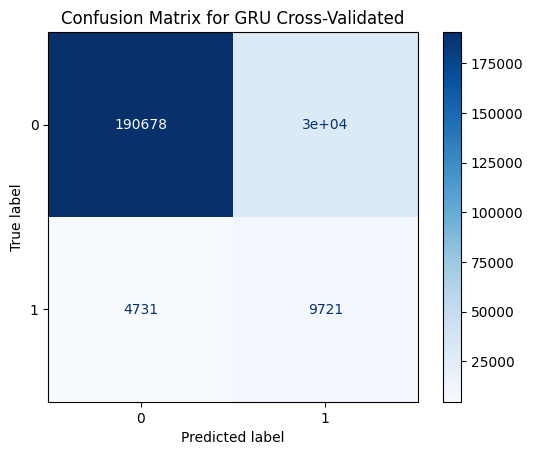

In [38]:
# Use your evaluate_model function on the aggregated predictions
print(f"List of best MCC's: {best_mccs}")
evaluate_model(all_y_pred, all_y_test, "GRU Cross-Validated")


# PEOPLE, GAP FILLING: (no), REMOVED LABELED UNLESS PEOPLE = 1
# List of best MCC's: [0.046551188768692235, 0.22706132515015565, 0.346300664242612, 0.23181524868833017, 0.4516399303758435]
# MCC: 0.2225

# PEOPLE, GAP FILLING: 15min, REMOVED LABELED UNLESS PEOPLE = 1
# List of best MCC's: [0.0, 0.26864031882540645, 0.5280654327010728, 0.35190085514812514, 0.5931260048891923]
# MCC: 0.4724

# PEOPLE, GAP FILLING: 30min, REMOVED LABELED UNLESS PEOPLE = 1
# List of best MCC's: [0.03667223788284764, 0.42653283259962743, 0.3087107552903388, 0.3096943189456269, 0.6600080595721066]
# MCC: 0.3011

# PEOPLE, GAP FILLING: 10min, REMOVED LABELED UNLESS PEOPLE = 1
# List of best MCC's: [0.06779038826005164, 0.31727283009764395, 0.42265767311682567, 0.24587434743046882, 0.5518959834158078]
# MCC: 0.3296

# PEOPLE, GAP FILLING: 20min, REMOVED LABELED UNLESS PEOPLE = 1
# List of best MCC's: [0.06865516658188439, 0.4024632462473223, 0.5946412456129851, 0.3099641614906547, 0.6595652805576259]
# MCC: 0.3844

# PEOPLE, GAP FILLING: 15min, REMOVED LABELED UNLESS PEOPLE = 1, REMOVED FILLED VALUES OF MOTION BASED ON PEOPLE_IN_ROOM
# List of best MCC's: [0.32791821502785734, 0.2351730085823336, 0.6418387057890684, 0.4305601543623735, 0.6319720817620966]
# MCC: 0.3770

# Permutation imporance with eli5

Epoch 1/30


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



7047/7047 ━━━━━━━━━━━━━━━━━━━━ 17s 2ms/step - accuracy: 0.9415 - loss: 0.2108 - val_accuracy: 0.9343 - val_loss: 0.1827
Epoch 2/30
7047/7047 ━━━━━━━━━━━━━━━━━━━━ 19s 2ms/step - accuracy: 0.9501 - loss: 0.1535 - val_accuracy: 0.9354 - val_loss: 0.1820
Epoch 3/30
7047/7047 ━━━━━━━━━━━━━━━━━━━━ 11s 1ms/step - accuracy: 0.9522 - loss: 0.1457 - val_accuracy: 0.9231 - val_loss: 0.2005
Epoch 4/30
7047/7047 ━━━━━━━━━━━━━━━━━━━━ 10s 1ms/step - accuracy: 0.9517 - loss: 0.1429 - val_accuracy: 0.9256 - val_loss: 0.1972
Epoch 5/30
7047/7047 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9523 - loss: 0.1407 - val_accuracy: 0.9221 - val_loss: 0.2051
Epoch 6/30
7047/7047 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9525 - loss: 0.1409 - val_accuracy: 0.9306 - val_loss: 0.1962
Epoch 7/30
7047/7047 ━━━━━━━━━━━━━━━━━━━━ 23s 2ms/step - accuracy: 0.9531 - loss: 0.1383 - val_accuracy: 0.9215 - val_loss: 0.2183
1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
Best MCC: 0.6285 at Threshold: 0.21499999999999983


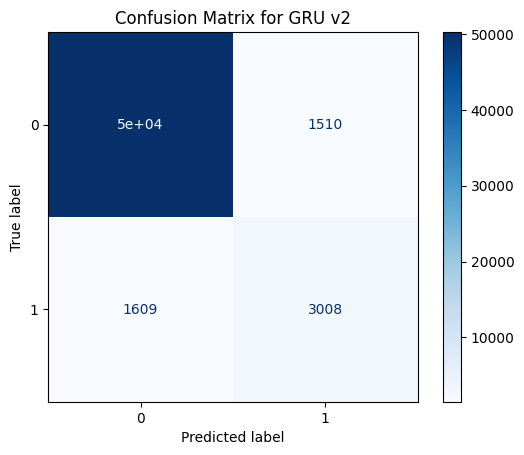

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from sklearn.metrics import matthews_corrcoef
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping

# Define your features and target.
features = ['NetCO2-CO2_ug', 'NetADC_O3-O3_ug', 'NetADC_CO-CO_ug',
            'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB_ug',
            'NetADC_NO2-NO2_ug']

# Assume sensor_df_normalized and merged_df are already defined.
X = sensor_df_normalized[features].values
# y = merged_df[['people_continuous']].values
y = merged_df[['people']].values

# Split data (using a simple train/test split).
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Reshape data for GRU input (samples, timesteps, features).
# Here we use a single timestep.
X_train = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Build the GRU model.
model = Sequential([
    GRU(16, activation='tanh', return_sequences=False, 
        input_shape=(X_train.shape[1], X_train.shape[2])),
    Dropout(0.2),
    Dense(8, activation='relu'),
    Dropout(0.2),
    Dense(1, activation='sigmoid')  # For binary classification
])

# Compile the model.
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Define early stopping.
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Train the model.
history = model.fit(
    X_train, y_train,
    validation_data=(X_test, y_test),
    epochs=30,
    batch_size=32,
    verbose=1,
    callbacks=[early_stopping]
)

# Predict probabilities on the test set.
y_pred_prob = model.predict(X_test)
# PEOPLE, THRESHOLD FILLING: 0, REMOVED LABELED, UNLESS PEOPLE = 1
# Best MCC: 0.4674 at Threshold: 0.17899999999999985

best_mcc = -1  # MCC ranges from -1 to 1
best_threshold = 0

for threshold in np.arange(0.01, 0.7, 0.001):
    # Binarize the predictions based on the threshold
    y_pred = (y_pred_prob > threshold).astype(int)
    
    mcc = matthews_corrcoef(y_test, y_pred)
    if mcc > best_mcc:
        best_mcc = mcc
        best_threshold = threshold

y_pred_class = (y_pred_prob > best_threshold).astype(int)

print(f"Best MCC: {best_mcc:.4f} at Threshold: {best_threshold}")
evaluate_model(y_pred_class, y_test, "GRU v2")

In [49]:
from sklearn.base import BaseEstimator

class GRUWrapper(BaseEstimator):
    def __init__(self, model):
        self.model = model

    def fit(self, X, y=None):
        # Since the model is already trained, we simply return self.
        return self

    def predict_proba(self, X):
        # Reshape from 2D (n_samples, n_features) to 3D (n_samples, 1, n_features)
        X_reshaped = X.reshape(X.shape[0], 1, X.shape[1])
        probs = self.model.predict(X_reshaped)
        # Squeeze to shape (n_samples,)
        probs = probs.squeeze()
        # Ensure it's 2D (n_samples, 1)
        if probs.ndim == 1:
            probs = probs.reshape(-1, 1)
        # Return probabilities for class 0 and class 1
        return np.hstack([1 - probs, probs])

    def predict(self, X, threshold=0.5):
        # Default prediction using the given threshold
        return (self.predict_proba(X)[:, 1] > threshold).astype(int)

    def score(self, X, y):
        """
        Searches for the best threshold that maximizes MCC on the provided data.
        """
        from sklearn.metrics import matthews_corrcoef

        y_pred_prob = self.predict_proba(X)[:, 1]
        best_mcc = -1  # MCC ranges from -1 to 1
        best_threshold = 0
        # Iterate over thresholds from 0.01 to 0.7 with a step of 0.001
        for threshold in np.arange(0.01, 0.7, 0.01):
            y_pred = (y_pred_prob > threshold).astype(int)
            mcc = matthews_corrcoef(y, y_pred)
            if mcc > best_mcc:
                best_mcc = mcc
                best_threshold = threshold
        print(f"Best threshold: {best_threshold}, Best MCC: {best_mcc}")
        return best_mcc


In [50]:
import eli5
from eli5.sklearn import PermutationImportance

X_test_2d = X_test.reshape(X_test.shape[0], X_test.shape[2])

# Wrap your trained model
wrapped_model = GRUWrapper(model)

# Set up permutation importance. You can adjust n_iter to average over several shuffles.
perm = PermutationImportance(wrapped_model, n_iter=10, random_state=42)

# Fit on the test set (using the original 2D version of X_test and y_test)
perm.fit(X_test_2d, y_test.ravel())

# Display the feature importances
eli5.show_weights(perm, feature_names=features)
#eli5.explain_weights(perm, feature_names=features)


1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 925us/step
Best threshold: 0.22, Best MCC: 0.6277972489378648
1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
Best threshold: 0.6900000000000001, Best MCC: 0.6443137420073971
1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 999us/step 
Best threshold: 0.22, Best MCC: 0.6111492114262553
1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 973us/step
Best threshold: 0.26, Best MCC: -0.0016684989699141059
1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
Best threshold: 0.28, Best MCC: 0.588172711380938
1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 919us/step
Best threshold: 0.17, Best MCC: 0.6169178313490865
1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 941us/step
Best threshold: 0.09999999999999999, Best MCC: 0.5356493118708058
1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 946us/step
Best threshold: 0.23, Best MCC: 0.616032939013478
1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
Best threshold: 0.6900000000000001, Best MCC: 0.6420825941247895
1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 913us/step
Best threshold: 0.22, Best MCC: 0.6100782664011597


Weight,Feature
0.6286 ± 0.0055,NetADC_CO-CO_ug
0.0935 ± 0.0060,NetPid_P1-PPB_ug
0.0364 ± 0.0035,NetPM-PM10(µg/m3)
0.0196 ± 0.0031,NetADC_O3-O3_ug
0.0113 ± 0.0027,NetADC_NO2-NO2_ug
0.0098 ± 0.0032,NetPM-PM25(µg/m3)
-0.0141 ± 0.0035,NetCO2-CO2_ug


# Permutation Importance

Originalni MCC: 0.6278 at Threshold: 0.22


Computing permutation importance:   0%|          | 0/7 [00:00<?, ?it/s]

1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 938us/step


Computing permutation importance:  14%|█▍        | 1/7 [00:03<00:19,  3.17s/it]

1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 939us/step


Computing permutation importance:  29%|██▊       | 2/7 [00:06<00:15,  3.17s/it]

1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 943us/step


Computing permutation importance:  43%|████▎     | 3/7 [00:09<00:12,  3.19s/it]

1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 948us/step


Computing permutation importance:  57%|█████▋    | 4/7 [00:12<00:09,  3.22s/it]

1762/1762 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step


Computing permutation importance:  71%|███████▏  | 5/7 [00:17<00:07,  3.68s/it]

1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step


Computing permutation importance:  86%|████████▌ | 6/7 [00:20<00:03,  3.67s/it]

1762/1762 ━━━━━━━━━━━━━━━━━━━━ 2s 992us/step


Computing permutation importance: 100%|██████████| 7/7 [00:24<00:00,  3.47s/it]


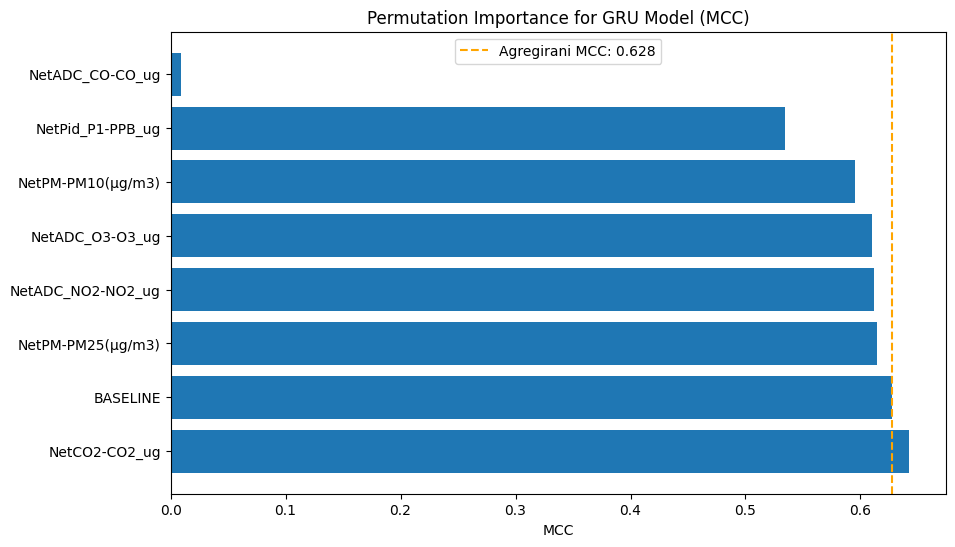

In [51]:
# Function to determine the best threshold based on MCC.
def best_mcc_threshold(y_true, y_pred_prob):
    best_mcc = -1  # MCC ranges from -1 to 1
    best_threshold = 0
    for threshold in np.arange(0.01, 0.7, 0.01):
        y_pred = (y_pred_prob > threshold).astype(int)
        mcc = matthews_corrcoef(y_true, y_pred)
        if mcc > best_mcc:
            best_mcc = mcc
            best_threshold = threshold
    return best_mcc, best_threshold

# Evaluate baseline performance.
baseline_mcc, baseline_threshold = best_mcc_threshold(y_test, y_pred_prob)
print(f"Originalni MCC: {baseline_mcc:.4f} at Threshold: {baseline_threshold}")

# Compute permutation importance using MCC.
results = []
results.append({'feature': 'BASELINE', 'mcc': baseline_mcc})

# Save a copy of the original test data.
X_test_original = X_test.copy()

# For each feature, permute its values and compute the new MCC.
for i in tqdm(range(X_test.shape[2]), desc="Computing permutation importance"):
    X_test_permuted = X_test_original.copy()
    # Shuffle the i-th feature column.
    np.random.shuffle(X_test_permuted[:, 0, i])
    
    # Get predictions with the permuted feature.
    y_pred_perm_prob = model.predict(X_test_permuted)
    
    # Compute the best MCC for the permuted data.
    perm_mcc, perm_threshold = best_mcc_threshold(y_test, y_pred_perm_prob)
    results.append({'feature': features[i], 'mcc': perm_mcc})

# Create a DataFrame with the results.
df_results = pd.DataFrame(results)
df_results = df_results.sort_values(by='mcc', ascending=False)
# Optionally, save the results to CSV.
df_results.to_csv('gru_permutation_importance_mcc.csv', index=False)

# Plot the permutation importance.
plt.figure(figsize=(10, 6))
plt.barh(df_results['feature'], df_results['mcc'])
plt.xlabel('MCC')
plt.title('Permutation Importance for GRU Model (MCC)')
plt.axvline(baseline_mcc, color='orange', linestyle='--', 
            label=f'Agregirani MCC: {baseline_mcc:.3f}')
plt.legend()
plt.show()